In [104]:
# dataframe and plotting
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

#importing plotly and cufflinks in offline mode
import cufflinks as cf
import plotly.offline
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)


import plotly 
import plotly.express as px
import plotly.graph_objs as go
import plotly.offline as py
from plotly.offline import iplot
from plotly.subplots import make_subplots
import plotly.figure_factory as ff


# machine learning
from sklearn.model_selection import train_test_split

import warnings
warnings.filterwarnings('ignore')

In [131]:
Train = pd.read_csv("./Data/Train.csv", na_values='na')
print(f'The DataFrame has {len(Train)} rows and {Train.shape[1]} columns.')


The DataFrame has 209499 rows and 43 columns.


In [132]:
Test = pd.read_csv("./Data/Test.csv", na_values='na')
print(f'The DataFrame has {len(Test)} rows and {Test.shape[1]} columns.')


The DataFrame has 89786 rows and 42 columns.


In [107]:
Varibles = pd.read_csv("./Data/VariableDefinitions.csv")
Submisson = pd.read_csv("./Data/SampleSubmission.csv")
Varibles

,Column,Description
0,age,Age Of Individual
1,gender,Gender
2,education,Education
3,class,Class Of Worker
4,education_institute,Enrolled Educational Institution in last week
5,marital_status,Marital_Status
6,race,Race
7,is_hispanic,Hispanic Origin
8,employment_commitment,Full Or Part Time Employment Stat
9,unemployment_reason,Reason For Unemployment


In [108]:
Train.head()

,ID,age,gender,education,class,education_institute,marital_status,race,is_hispanic,employment_commitment,...,country_of_birth_mother,migration_code_change_in_msa,migration_prev_sunbelt,migration_code_move_within_reg,migration_code_change_in_reg,residence_1_year_ago,old_residence_reg,old_residence_state,importance_of_record,income_above_limit
0,ID_TZ0000,79,Female,High school graduate,NaN,NaN,Widowed,White,All other,Not in labor force,...,US,?,?,?,?,NaN,NaN,NaN,1779.74,Below limit
1,ID_TZ0001,65,Female,High school graduate,NaN,NaN,Widowed,White,All other,Children or Armed Forces,...,US,unchanged,NaN,unchanged,unchanged,Same,NaN,NaN,2366.75,Below limit
2,ID_TZ0002,21,Male,12th grade no diploma,Federal government,NaN,Never married,Black,All other,Children or Armed Forces,...,US,unchanged,NaN,unchanged,unchanged,Same,NaN,NaN,1693.42,Below limit
3,ID_TZ0003,2,Female,Children,NaN,NaN,Never married,Asian or Pacific Islander,All other,Children or Armed Forces,...,India,unchanged,NaN,unchanged,unchanged,Same,NaN,NaN,1380.27,Below limit
4,ID_TZ0004,70,Male,High school graduate,NaN,NaN,Married-civilian spouse present,White,All other,Not in labor force,...,US,?,?,?,?,NaN,NaN,NaN,1580.79,Below limit


In [109]:
Train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 209499 entries, 0 to 209498
Data columns (total 43 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   ID                              209499 non-null  object 
 1   age                             209499 non-null  int64  
 2   gender                          209499 non-null  object 
 3   education                       209499 non-null  object 
 4   class                           104254 non-null  object 
 5   education_institute             13302 non-null   object 
 6   marital_status                  209499 non-null  object 
 7   race                            209499 non-null  object 
 8   is_hispanic                     209499 non-null  object 
 9   employment_commitment           209499 non-null  object 
 10  unemployment_reason             6520 non-null    object 
 11  employment_stat                 209499 non-null  int64  
 12  wage_per_hour   

In [110]:
#List the columns for different datatypes:
print('List of all Columns: ')
print(Train.columns)
print('\n')
print('Integer Type: ')
Col_int = Train.select_dtypes(np.int64).columns
print(Col_int)
print('\n')
print('Float Type: ')
Col_float = Train.select_dtypes(np.float64).columns
print(Col_float)
print('\n')
print('Object Type: ')
Col_cat = Train.select_dtypes(object).columns
print(Col_cat)
print('\n')
print('Count:')
print(Train.dtypes.value_counts())

List of all Columns: 
Index(['ID', 'age', 'gender', 'education', 'class', 'education_institute',
       'marital_status', 'race', 'is_hispanic', 'employment_commitment',
       'unemployment_reason', 'employment_stat', 'wage_per_hour',
       'is_labor_union', 'working_week_per_year', 'industry_code',
       'industry_code_main', 'occupation_code', 'occupation_code_main',
       'total_employed', 'household_stat', 'household_summary',
       'under_18_family', 'veterans_admin_questionnaire', 'vet_benefit',
       'tax_status', 'gains', 'losses', 'stocks_status', 'citizenship',
       'mig_year', 'country_of_birth_own', 'country_of_birth_father',
       'country_of_birth_mother', 'migration_code_change_in_msa',
       'migration_prev_sunbelt', 'migration_code_move_within_reg',
       'migration_code_change_in_reg', 'residence_1_year_ago',
       'old_residence_reg', 'old_residence_state', 'importance_of_record',
       'income_above_limit'],
      dtype='object')


Integer Type: 
Index(

In [112]:
Train[['age', 'employment_stat', 'wage_per_hour', 'working_week_per_year',
       'industry_code', 'occupation_code', 'total_employed', 'vet_benefit',
       'gains', 'losses', 'stocks_status', 'mig_year', 'importance_of_record'
       ]].iplot(kind='histogram',subplots=True,bins=50)

The Class imbalance in term of precentage is Given by:


Below limit    0.937957
Above limit    0.062043
Name: income_above_limit, dtype: float64

------------------------------------------



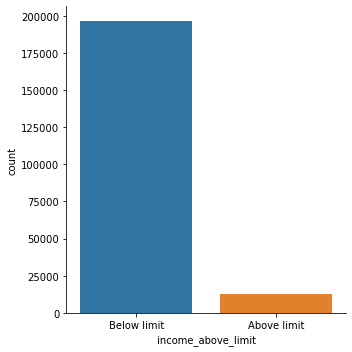

In [113]:
print("The Class imbalance in term of precentage is Given by:")
display(Train['income_above_limit'].value_counts(normalize = True))
print('------------------------------------------\n')

# Explore Target distribution 
sns.catplot(x="income_above_limit", kind="count", data=Train)

In [114]:
# Check for missing values
print('missing values:', Train.isnull().sum().sort_values(ascending = False))

missing values: veterans_admin_questionnaire      207415
unemployment_reason               202979
education_institute               196197
old_residence_state               193148
old_residence_reg                 193148
is_labor_union                    189420
under_18_family                   151654
residence_1_year_ago              106284
occupation_code_main              105694
class                             105245
migration_prev_sunbelt             88452
migration_code_change_in_msa        1588
migration_code_change_in_reg        1588
migration_code_move_within_reg      1588
losses                                 0
stocks_status                          0
citizenship                            0
ID                                     0
mig_year                               0
country_of_birth_own                   0
country_of_birth_father                0
country_of_birth_mother                0
tax_status                             0
importance_of_record                   0


In [133]:
# Removes Data Duplicates while Retaining the First one
def remove_duplicate(data):
    data.drop_duplicates(keep="first", inplace=True)
    return "Checked Duplicates"

# Removes Duplicates from train data if any
remove_duplicate(Train)

'Checked Duplicates'

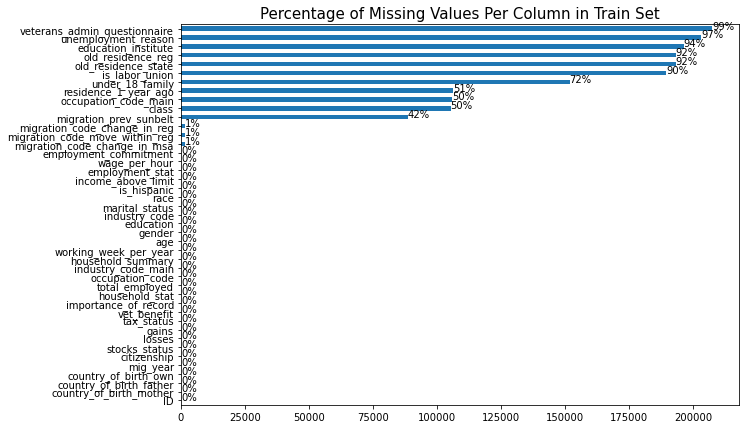

In [116]:
# Check if there any missing values in train set
ax = Train.isna().sum().sort_values().plot(kind = 'barh', figsize = (10, 7))
plt.title('Percentage of Missing Values Per Column in Train Set', fontdict={'size':15})
for p in ax.patches:
    percentage ='{:,.0f}%'.format((p.get_width()/Train.shape[0])*100)
    width, height =p.get_width(),p.get_height()
    x=p.get_x()+width+0.02
    y=p.get_y()+height/2
    ax.annotate(percentage,(x,y))

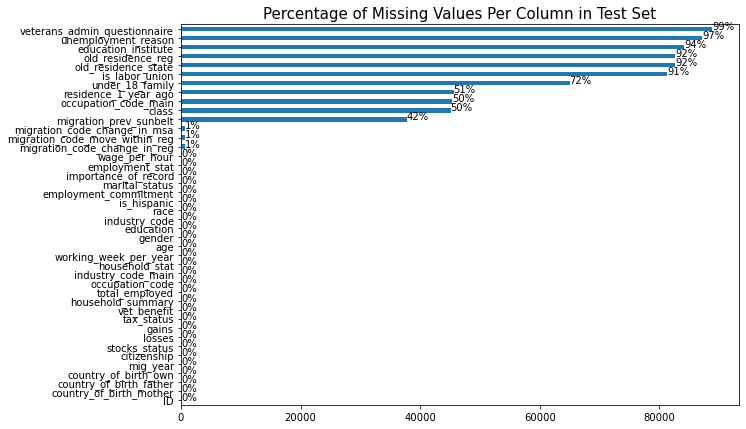

In [117]:
# Check if there any missing values in test set
ax = Test.isna().sum().sort_values().plot(kind = 'barh', figsize = (10, 7))
plt.title('Percentage of Missing Values Per Column in Test Set', fontdict={'size':15})
for p in ax.patches:
    percentage ='{:,.0f}%'.format((p.get_width()/Test.shape[0])*100)
    width, height =p.get_width(),p.get_height()
    x=p.get_x()+width+0.02
    y=p.get_y()+height/2
    ax.annotate(percentage,(x,y))

<AxesSubplot:>

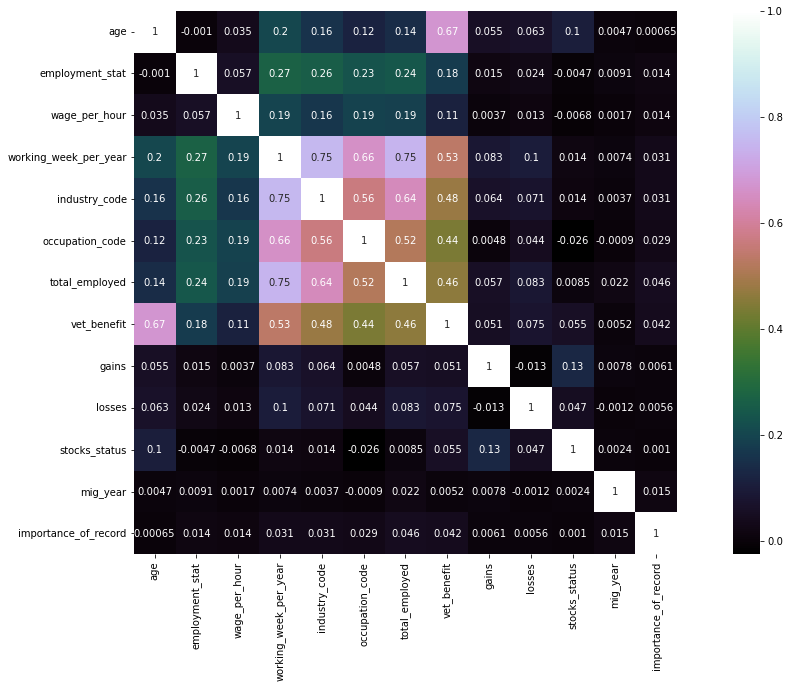

In [118]:
# GETTING Correllation matrix
corr_mat= Train.corr(method='pearson')
plt.figure(figsize=(20,10))
sns.heatmap(corr_mat,vmax=1,square=True,annot=True,cmap='cubehelix')

### 3. Data preparation for machine learning
Before you train the model for prediction, you need to perform data [cleaning](https://www.dataquest.io/blog/machine-learning-preparing-data/) and [preprocessing](https://towardsdatascience.com/data-preprocessing-concepts-fa946d11c825). This is a very important step; your model will not perform well without these steps.

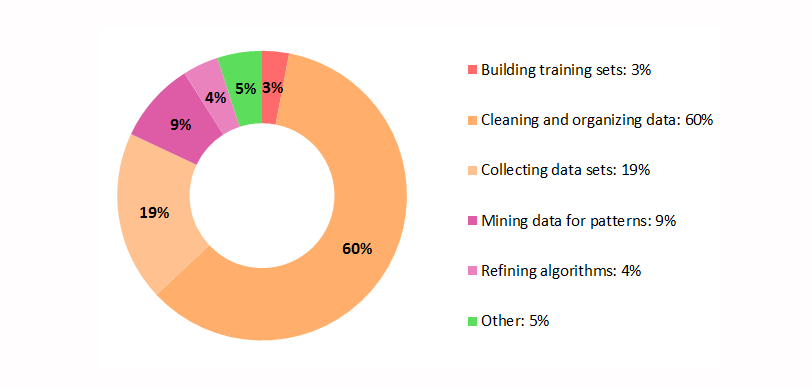

The first step is to separate the independent variables and target(bank_account) from the train data. Then transform the target values from the object data type into numerical by using [LabelEncoder](https://towardsdatascience.com/categorical-encoding-using-label-encoding-and-one-hot-encoder-911ef77fb5bd).


In [134]:
Train = Train.loc[:, Train.isnull().sum() < 0.8*Train.shape[0]]
print(f'The DataFrame has {len(Train)} rows and {Train.shape[1]} columns.')

The DataFrame has 209499 rows and 37 columns.


In [135]:
Test = Test.loc[:, Test.isnull().sum() < 0.8*Test.shape[0]]

print(f'The DataFrame has {len(Test)} rows and {Test.shape[1]} columns.')

The DataFrame has 89786 rows and 36 columns.


In [121]:
# Train['under_18_family_M'] = np.where(Train['under_18_family'].isna(), True,False).astype(object)
# Train['residence_1_year_ago_M'] = np.where(Train['residence_1_year_ago'].isna(), True,False).astype(object)
# Train['occupation_code_main_M'] = np.where(Train['occupation_code_main'].isna(), True,False).astype(object)
# Train['class_M'] = np.where(Train['class'].isna(), True,False).astype(object)
# Train['migration_prev_sunbelt_M'] = np.where(Train['migration_prev_sunbelt'].isna(), True,False).astype(object)
# Train['migration_code_change_in_reg_M'] = np.where(Train['migration_code_change_in_reg'].isna(), True,False).astype(object)
# Train['migration_code_move_within_reg_M'] = np.where(Train['migration_code_move_within_reg'].isna(), True,False).astype(object)
# Train['migration_code_change_in_msa_M'] = np.where(Train['migration_code_change_in_msa'].isna(), True,False).astype(object)


In [122]:
# Test['under_18_family_M'] = np.where(Test['under_18_family'].isna(), True,False).astype(object)
# Test['residence_1_year_ago_M'] = np.where(Test['residence_1_year_ago'].isna(), True,False).astype(object)
# Test['occupation_code_main_M'] = np.where(Test['occupation_code_main'].isna(), True,False).astype(object)
# Test['class_M'] = np.where(Test['class'].isna(), True,False).astype(object)
# Test['migration_prev_sunbelt_M'] = np.where(Test['migration_prev_sunbelt'].isna(), True,False).astype(object)
# Test['migration_code_change_in_reg_M'] = np.where(Test['migration_code_change_in_reg'].isna(), True,False).astype(object)
# Test['migration_code_move_within_reg_M'] = np.where(Test['migration_code_move_within_reg'].isna(), True,False).astype(object)
# Test['migration_code_change_in_msa_M'] = np.where(Test['migration_code_change_in_msa'].isna(), True,False).astype(object)


In [136]:
categorical = Train.select_dtypes('object').columns
print(f'Categorical Columns: {Train[categorical].columns}')

Categorical Columns: Index(['ID', 'gender', 'education', 'class', 'marital_status', 'race',
       'is_hispanic', 'employment_commitment', 'industry_code_main',
       'occupation_code_main', 'household_stat', 'household_summary',
       'under_18_family', 'tax_status', 'citizenship', 'country_of_birth_own',
       'country_of_birth_father', 'country_of_birth_mother',
       'migration_code_change_in_msa', 'migration_prev_sunbelt',
       'migration_code_move_within_reg', 'migration_code_change_in_reg',
       'residence_1_year_ago', 'income_above_limit'],
      dtype='object')


In [137]:
numerical= Train.select_dtypes('number').columns

print(f'Numerical Columns:  {Train[numerical].columns}')

Numerical Columns:  Index(['age', 'employment_stat', 'wage_per_hour', 'working_week_per_year',
       'industry_code', 'occupation_code', 'total_employed', 'vet_benefit',
       'gains', 'losses', 'stocks_status', 'mig_year', 'importance_of_record'],
      dtype='object')


In [139]:
Train[categorical].nunique()

ID                                209499
gender                                 2
education                             17
class                                  8
marital_status                         7
race                                   5
is_hispanic                           10
employment_commitment                  8
industry_code_main                    24
occupation_code_main                  14
household_stat                        38
household_summary                      8
under_18_family                        4
tax_status                             6
citizenship                            5
country_of_birth_own                  43
country_of_birth_father               43
country_of_birth_mother               43
migration_code_change_in_msa           9
migration_prev_sunbelt                 3
migration_code_move_within_reg         9
migration_code_change_in_reg           8
residence_1_year_ago                   2
income_above_limit                     2
dtype: int64

### Correlation vs. Collinearity vs. Multicollinearity
If you recall, correlation measures the strength and direction between two columns in 
your dataset. Correlation is often used to find the relationship between a feature and 
the target:

In [ ]:
# def uncorrelated_features(df, threshold=0.95):
#     """
#     Returns a subset of df columns with Pearson correlations
#     below threshold.
#     """

#     corr = df.corr().abs()
#     keep = []
#     for i in range(len(corr.iloc[:,0])):
#         above = corr.iloc[:i,i]
#         if len(keep) > 0: above = above[keep]
#         if len(above[above < threshold]) == len(above):
#             keep.append(corr.columns.values[i])

#     return df[keep]

# Train = uncorrelated_features(df=Train,threshold=0.95)
# Test = uncorrelated_features(df=Test,threshold=0.95)

In [140]:
#import preprocessing module
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler

# Cobvert target label to numerical Data
le = LabelEncoder()
Train['income_above_limit'] = le.fit_transform(Train['income_above_limit'])

#Separate training features from target
X_train = Train.drop(['income_above_limit'], axis=1)
y_train = Train['income_above_limit']

y_train.head(2)

0    1
1    1
Name: income_above_limit, dtype: int32

In [143]:
from sklearn.impute import SimpleImputer

CAT = ['ID', 'gender', 'education', 'class', 'marital_status', 'race',
       'is_hispanic', 'employment_commitment', 'industry_code_main',
       'occupation_code_main', 'household_stat', 'household_summary',
       'under_18_family', 'tax_status', 'citizenship', 'country_of_birth_own',
       'country_of_birth_father', 'country_of_birth_mother',
       'migration_code_change_in_msa', 'migration_prev_sunbelt',
       'migration_code_move_within_reg', 'migration_code_change_in_reg',
       'residence_1_year_ago']
for col in CAT:
    cat_imputer = SimpleImputer(strategy='most_frequent')
    cat_imputer.fit(X_train[[col]])
    X_train.loc[:, col] = cat_imputer.transform(X_train[[col]])
    Test.loc[:, col] = cat_imputer.transform(Test[[col]]) # Apply to the Test Data

In [148]:
# function to preprocess our data from train models
def preprocessing_data(data):

    # Convert the following numerical labels from interger to float
    float_array = data[['age', 'employment_stat', 'wage_per_hour', 'working_week_per_year',
       'industry_code', 'occupation_code', 'total_employed', 'vet_benefit',
       'gains', 'losses', 'stocks_status', 'mig_year'
       ]].values.astype(float)
    
    # categorical features to be onverted to One Hot Encoding
    categ = ['gender',  'class', 'marital_status', 'race',
       'employment_commitment',  'household_summary',
       'under_18_family', 'tax_status', 'citizenship', 
       'migration_code_change_in_msa', 'migration_prev_sunbelt',
       'migration_code_move_within_reg', 'migration_code_change_in_reg',
       'residence_1_year_ago'
      # , 'migration_code_move_within_reg_M',
      #  'under_18_family_M', 'residence_1_year_ago_M', 'occupation_code_main_M',
      #  'class_M', 'migration_prev_sunbelt_M', 'migration_code_change_in_reg_M',
      #  'migration_code_change_in_msa_M'

    ]
    
    # One Hot Encoding conversion
    data = pd.get_dummies(data, prefix_sep="_", columns=categ)
    
    # Label Encoder conversion
    data["education"] = le.fit_transform(data["education"])
    data["is_hispanic"] = le.fit_transform(data["is_hispanic"])
    data["industry_code_main"] = le.fit_transform(data["industry_code_main"])
    data["occupation_code_main"] = le.fit_transform(data["occupation_code_main"])
    data["household_stat"] = le.fit_transform(data["household_stat"])
    data["country_of_birth_own"] = le.fit_transform(data["country_of_birth_own"])
    data["country_of_birth_father"] = le.fit_transform(data["country_of_birth_father"])
    data["country_of_birth_mother"] = le.fit_transform(data["country_of_birth_mother"])
    
    # drop uniquid column
    data = data.drop(["ID"], axis=1)
    
    # scale our data into range of 0 and 1
    scaler = MinMaxScaler(feature_range=(0, 1))
    data = scaler.fit_transform(data)
    
    return data  

In [149]:
# preprocess the train data 
processed_train = preprocessing_data(X_train)
processed_test = preprocessing_data(Test)

In [150]:
# the first train row
print(processed_train[:1])

[[0.87777778 0.75       0.         0.         0.         1.
  0.         0.60869565 0.         0.         0.33333333 0.54054054
  1.         0.         0.         0.00292003 1.         1.
  1.         1.         0.09355622 1.         0.         0.
  0.         0.         1.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         1.         0.         0.         0.         0.
  1.         0.         0.         1.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         1.         0.         0.         0.         1.
  0.         0.         0.         1.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         1.         1.         0.         0.         0.
  0.         0.         0.         0.         0.         1.
  0.         0.         1.         0.         0.         0.
  0.         0.         0.         0.         0.         1.
  0.         0.         0.      

In [151]:
# Split train_data
from sklearn.model_selection import train_test_split

X_Train, X_Val, y_Train, y_val = train_test_split(processed_train, y_train, stratify = y_train, 
                                                  test_size = 0.3, random_state=42)

In [152]:
#import classifier algorithm here
from catboost import CatBoostClassifier
from catboost import Pool


train_pool = Pool(X_Train, y_Train)
val_pool = Pool(X_Val, y_val)

In [153]:
Cat_Features = ['gender', 'education', 'class', 'marital_status', 'race',
       'is_hispanic', 'employment_commitment', 'industry_code_main',
       'occupation_code_main', 'household_stat', 'household_summary',
       'under_18_family', 'tax_status', 'citizenship', 'country_of_birth_own',
       'country_of_birth_father', 'country_of_birth_mother',
       'migration_code_change_in_msa', 'migration_prev_sunbelt',
       'migration_code_move_within_reg', 'migration_code_change_in_reg',
       'residence_1_year_ago']

In [1]:
catboost_base = CatBoostClassifier(
    iterations=100,
    depth=5,
    loss_function="CrossEntropy",
    eval_metric='Logloss',
    random_seed = 42,
    bagging_temperature=0.2,
    od_type='Iter',
    od_wait=20
    #cat_features= Cat_Features
    
)

NameError: name 'CatBoostClassifier' is not defined

In [159]:
catboost_base.fit(train_pool,eval_set=val_pool,plot=True,metric_period=10,verbose=50)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6222204	test: 0.6222260	best: 0.6222260 (0)	total: 1.09s	remaining: 9m 2s
50:	learn: 0.1316959	test: 0.1346527	best: 0.1346527 (50)	total: 26.1s	remaining: 3m 49s
100:	learn: 0.1175755	test: 0.1225646	best: 0.1225646 (100)	total: 44s	remaining: 2m 53s
150:	learn: 0.1117117	test: 0.1187710	best: 0.1187710 (150)	total: 1m	remaining: 2m 19s
200:	learn: 0.1076068	test: 0.1168674	best: 0.1168674 (200)	total: 1m 17s	remaining: 1m 54s
250:	learn: 0.1043137	test: 0.1157656	best: 0.1157656 (250)	total: 1m 36s	remaining: 1m 35s
300:	learn: 0.1013588	test: 0.1149743	best: 0.1149743 (300)	total: 1m 54s	remaining: 1m 15s


: 

: 